<span style="font-size:30px">**本文档为2023年所做的 ML SKA foreground removal 工作总结**  
**其中包括比较主要的代码、结果与研究思路说明**</span>

<span style="font-size:20px">**首先是对数据特征的基本展示**  
**EOR图像&skymap图像&psf图像（real space and frequency space）**

In [8]:
# 加载所需库与数据
# fits文件→numpy数组
import numpy as np
from astropy.io import fits
import matplotlib.pyplot as plt

cube_21cm = np.zeros([61,2048,2048],dtype=float)
cube_sync = np.zeros([61,2048,2048],dtype=float)
cube_halo = np.zeros([61,2048,2048],dtype=float)
cube_ff = np.zeros([61,2048,2048],dtype=float)
cube_ptr = np.zeros([61,2048,2048],dtype=float)
cube_dirty = np.zeros([61,2048,2048],dtype=float)
cube_psf = np.zeros([61,2048,2048],dtype=float)
cube_uvpsf = np.zeros([61,2048,2048],dtype=float)

freq = ['150.00','150.10','150.20','150.30','150.40','150.50','150.60','150.70','150.80','150.90','151.00','151.10','151.20','151.30','151.40','151.50','151.60','151.70','151.80','151.90','152.00','152.10','152.20','152.30','152.40','152.50','152.60','152.70','152.80','152.90','153.00','153.10','153.20','153.30','153.40','153.50','153.60','153.70','153.80','153.90','154.00','154.10','154.20','154.30','154.40','154.50','154.60','154.70','154.80','154.90','155.00','155.10','155.20','155.30','155.40','155.50','155.60','155.70','155.80','155.90','156.00']
for i,j in enumerate(freq):
    file_21cm = '/public/share/ace66so15x/share/sdc3_skymap/eor/deltaTb_f'+j+'_N2048_fov9.1.fits'
    file_sync = '/public/share/ace66so15x/share/sdc3_skymap/sync/gsync_'+j+'.fits'
    file_halo = '/public/share/ace66so15x/share/sdc3_skymap/halo/cluster_'+j+'.fits'
    file_ff='/public/share/ace66so15x/share/sdc3_skymap/ff/gfree_'+j+'.fits'
    file_ptr='/public/share/ace66so15x/share/sdc3_skymap/ptr/ptr_'+j+'.fits'
    file_dirty = '/public/share/ace66so15x/share/sdc3/all_'+j+'/image_briggs/all_'+j+'-dirty.fits'
    file_psf = '/public/share/ace66so15x/share/sdc3/all_'+j+'/image_briggs/all_'+j+'-psf.fits'
    file_psf_uv_real='/public/share/ace66so15x/share/sdc3/all_'+j+'/image_briggs/all_'+j+'-uvpsf-real.fits'

    data_21cm = fits.open(file_21cm)
    data_sync = fits.open(file_sync)
    data_halo = fits.open(file_halo)
    data_ff = fits.open(file_ff)
    data_ptr = fits.open(file_ptr)
    data_dirty = fits.open(file_dirty)
    data_psf=fits.open(file_psf)
    data_uvpsfreal = fits.open(file_psf_uv_real)

    cube_21cm[i] = data_21cm[0].data
    cube_sync[i] = data_sync[0].data
    cube_halo[i] = data_halo[0].data
    cube_ff[i]=data_ff[0].data
    cube_ptr[i]=data_ptr[0].data
    cube_dirty[i]=data_dirty[0].data
    cube_psf[i]=data_psf[0].data
    cube_uvpsf[i]=data_uvpsfreal[0].data


cube_total = cube_dirty
cube_cleanfg=cube_sync + cube_halo+cube_ff+cube_ptr
cube_dirtyfg=cube_total*1e8-cube_cleanfg

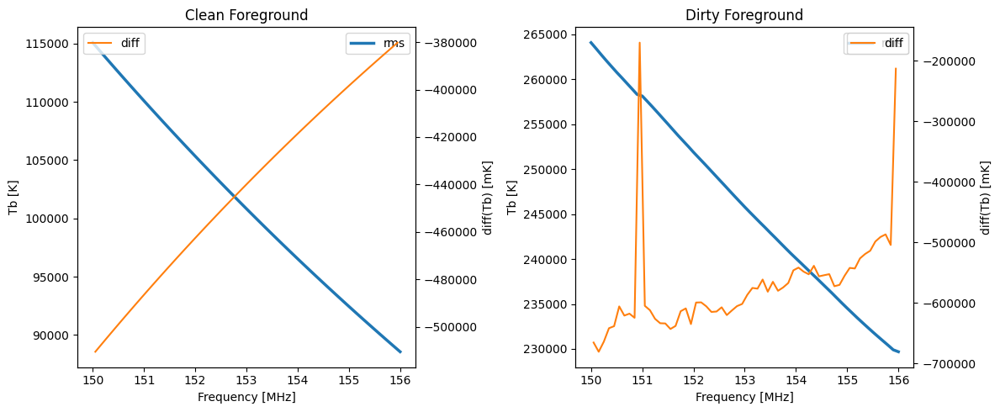

In [14]:
# 绘制skymap foregound 与 dirtymap foreground 随频率的变化 → dirty foreground 随频率变化不光滑 → 传统 EOR foreground removal 方法的失效

#方均根
def rms(a, axis=None):
    return np.sqrt(np.mean(a**2, axis=axis))

#绘图函数
def plot_cubes(cube_cleanfg, cube_dirtyfg):
    nfreq = cube_cleanfg.shape[0]
    freqs = np.linspace(150, 156, nfreq)
    fmid = (freqs[1:] + freqs[:-1]) / 2
    
    fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=(12, 5))

    ax = ax0
    cleanfg_rms = rms(cube_cleanfg, axis=(1,2)) 
    ax.plot(freqs, cleanfg_rms, lw=2.5, label='rms')   #lw是line width
    ax.legend()
    ax.set(xlabel='Frequency [MHz]', ylabel='Tb [K]', title='Clean Foreground')
    ax_ = ax.twinx()
    ax_.plot(fmid, np.diff(cleanfg_rms)*1e3, color='C1', label='diff')
    ax_.legend()
    ax_.set(ylabel='diff(Tb) [mK]')
    ax_.grid(False)

    ax = ax1
    dirtyfg_rms = rms(cube_dirtyfg, axis=(1,2))
    ax.plot(freqs, dirtyfg_rms , lw=2.5, label='rms')
    ax.legend()
    ax.set(xlabel='Frequency [MHz]', ylabel='Tb [K]', title='Dirty Foreground')
    ax_ = ax.twinx()
    ax_.plot(fmid, np.diff(dirtyfg_rms)*1e3, color='C1', label='diff')
    ax_.legend()
    ax_.set(ylabel='diff(Tb) [mK]')
    ax_.grid(False)

    fig.tight_layout()
    plt.show()
    
#绘制图像
plot_cubes(cube_cleanfg,cube_dirtyfg)
    

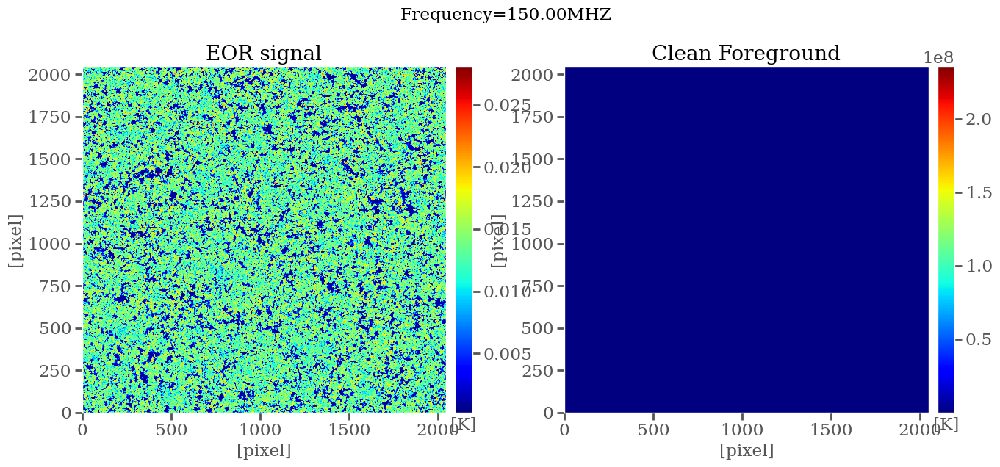

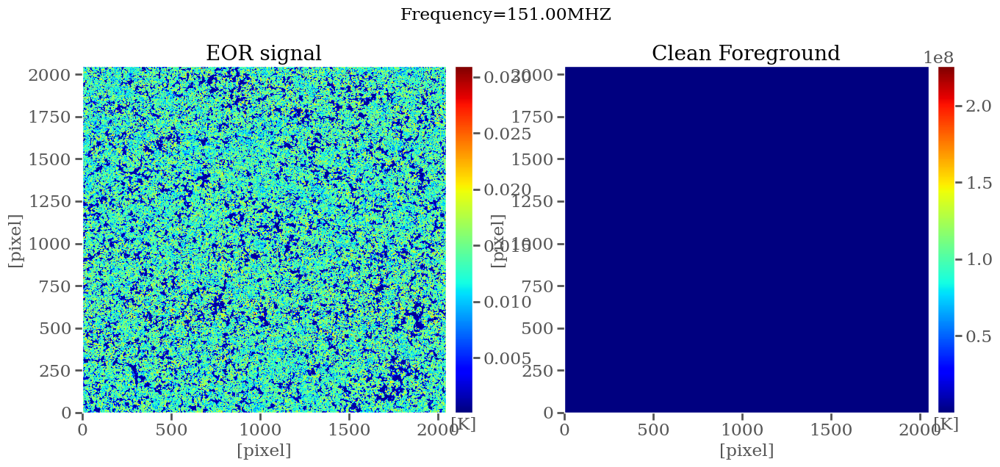

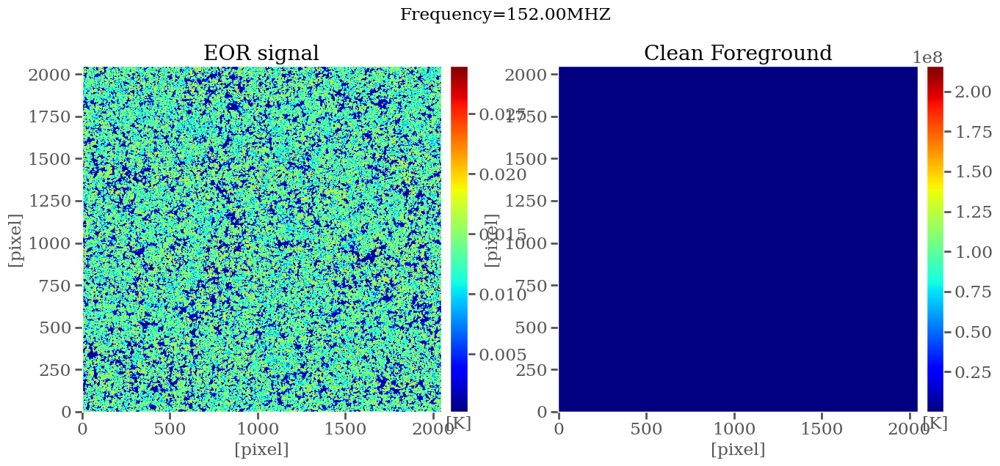

In [9]:
# 绘制不同频率下的21cm信号与skymap foreground → 可以看到明显的均匀性的区别

def plot_slice(cube_21cm, cube_fg, i, figsize=(14, 6.5)):
    fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=figsize)
    fig.suptitle('Frequency='+freq[i]+'MHZ')

    ax = ax0
    slc_eor = cube_21cm[i, :, :]  #读取对应频率的切片
    nx, ny = slc_eor.shape
    minimum=np.min(slc_eor)
    maximum=np.max(slc_eor)
    mappable = ax.pcolormesh(np.arange(nx), np.arange(ny), slc_eor, cmap='jet',vmin=minimum,vmax=maximum)
    cb = ax.figure.colorbar(mappable, ax=ax, pad=0.02, aspect=20)
    cb.ax.set_xlabel('[K]')
    ax.set(title='EOR signal', xlabel='[pixel]', ylabel='[pixel]')

    ax = ax1
    slc_fg = cube_fg[i, :, :]
    nx, ny = slc_fg.shape
    minimum=np.min(slc_fg)
    maximum=np.max(slc_fg)
    mappable = ax.pcolormesh(np.arange(nx), np.arange(ny), slc_fg, cmap='jet',vmin=minimum,vmax=maximum)
    cb = ax.figure.colorbar(mappable, ax=ax, pad=0.02, aspect=20)
    cb.ax.set_xlabel('[K]')
    ax.set(title='Clean Foreground', xlabel='[pixel]', ylabel='[pixel]')

    fig.tight_layout()
    fig.subplots_adjust(wspace=0.1)
    plt.show()
    return (fig, (ax0, ax1))

for i in [0,10,20]:
    fig, axes = plot_slice(cube_21cm, cube_cleanfg, i)

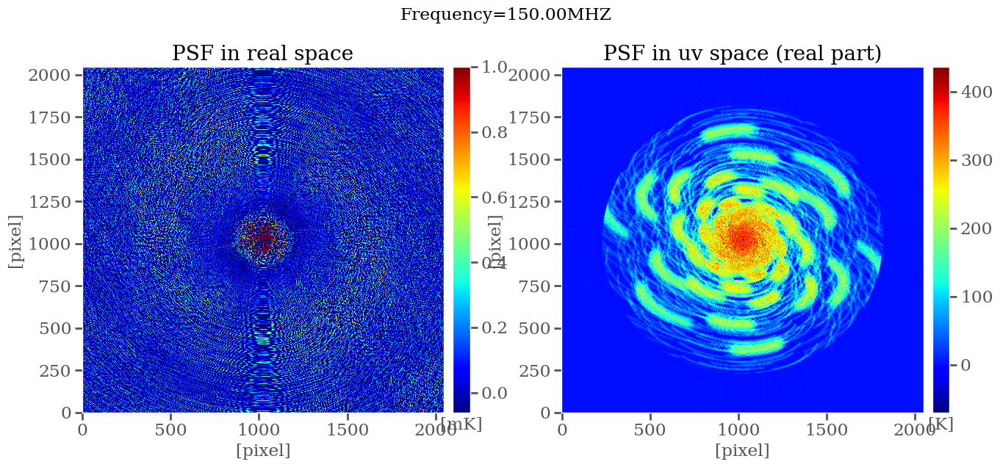

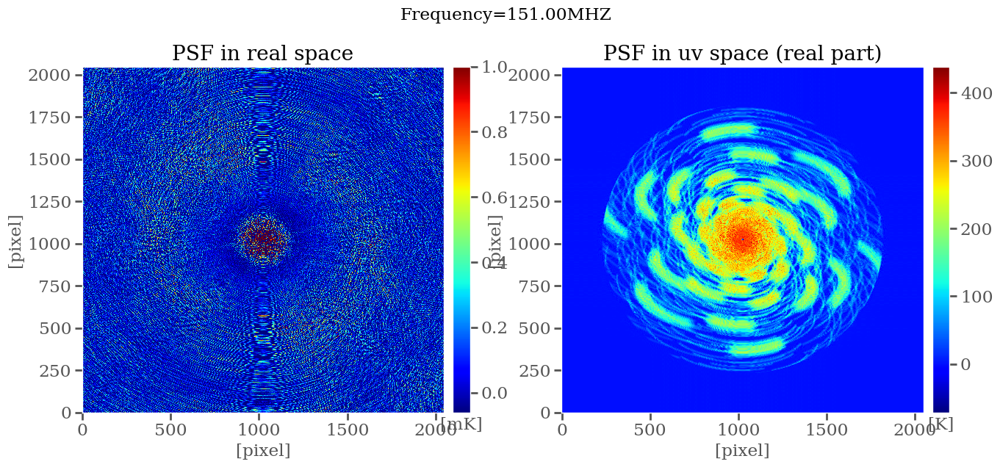

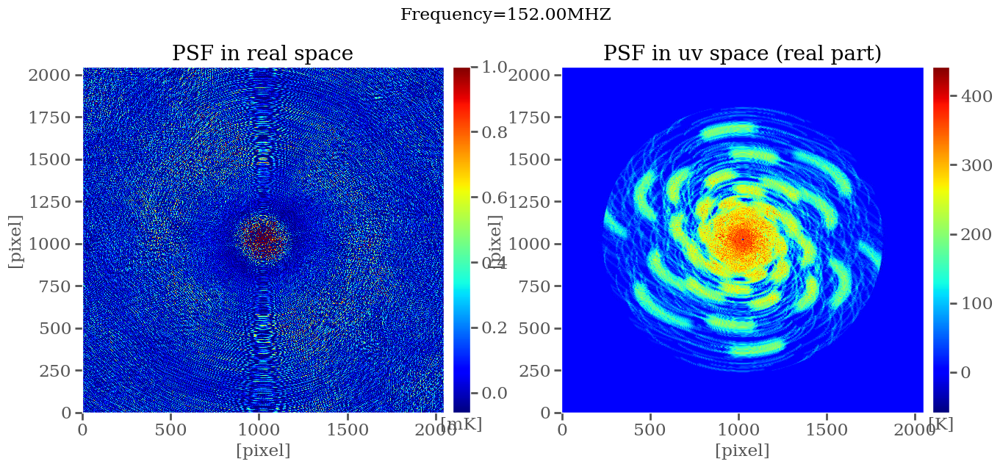

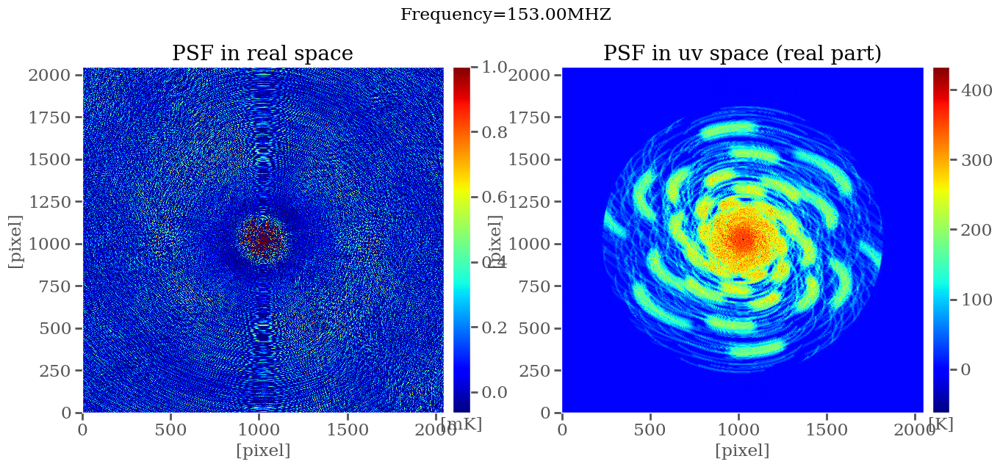

In [10]:
# 绘制响应的频率下的 实空间psf 与 uv空间psf实部 → 可以看到明显的点扩散效应

def plot_slice(cube_21cm, cube_fg, i, figsize=(14, 6.5)):
    fig, (ax0, ax1) = plt.subplots(ncols=2, figsize=figsize)
    fig.suptitle('Frequency='+freq[i]+'MHZ')

    ax = ax0
    slc_eor = cube_21cm[i, :, :]  #读取对应频率的切片
    nx, ny = slc_eor.shape
    minimum=np.min(slc_eor)
    maximum=np.max(slc_eor)
    mappable = ax.pcolormesh(np.arange(nx), np.arange(ny), slc_eor*1e3, cmap='jet',vmin=minimum,vmax=maximum)
    cb = ax.figure.colorbar(mappable, ax=ax, pad=0.02, aspect=20)
    cb.ax.set_xlabel('[mK]')
    ax.set(title='PSF in real space', xlabel='[pixel]', ylabel='[pixel]')

    ax = ax1
    slc_fg = cube_fg[i, :, :]
    nx, ny = slc_fg.shape
    minimum=np.min(slc_fg)
    maximum=np.max(slc_fg)
    mappable = ax.pcolormesh(np.arange(nx), np.arange(ny), slc_fg, cmap='jet',vmin=minimum,vmax=maximum)
    cb = ax.figure.colorbar(mappable, ax=ax, pad=0.02, aspect=20)
    cb.ax.set_xlabel('[K]')
    ax.set(title='PSF in uv space (real part)', xlabel='[pixel]', ylabel='[pixel]')

    fig.tight_layout()
    fig.subplots_adjust(wspace=0.1)
    plt.show()
    return (fig, (ax0, ax1))

for i in [0,10,20,30]:
    fig, axes = plot_slice(cube_psf, cube_uvpsf,i)

<span style="font-size:20px">**观察了数据的基本特征之后基于cdae-eor代码尝试做skymap的去前景（即不包括psf的效应）**</span>


In [3]:
#下面所有的步骤都是在cdae的原程序上做了相应的修改，而没有更改基本的思路
#编码器 → 解码器
#经过实验发现在频域空间上进行学习效果显著好，故这是对skymap进行傅里叶变换后的结果
#训练集与测试集的设置方式为把一张天图分割成两部分(2048*2048 → 1400*1400 + 448*448)
#该程序运行是需要加载的环境为tensorflow1120(因为是学长的原始版本)

#程序中的注释为初次阅读代码时为辅助理解所加

#import库
import os
from os import path
from datetime import datetime
import time

import numpy as np
from astropy.io import fits
#from astropy.cosmology import FlatLambdaCDM
#from astropy import constants as ac

from scipy import signal
from scipy import fftpack

import matplotlib as mpl
import matplotlib.pyplot as plt

#%matplotlib inline

mpl.style.use("ggplot")
for k, v in [("font.family",       "Inconsolata"),
             ("font.size",         14.0),
             ("pdf.fonttype",      42),  # Type 42 (a.k.a. TrueType)
             ("figure.figsize",    [8, 6]),
             ("image.cmap",        "jet"),
             ("xtick.labelsize",   "large"),
             ("xtick.major.size",  7.0),
             ("xtick.major.width", 2.0),
             ("xtick.minor.size",  4.0),
             ("xtick.minor.width", 1.5),
             ("ytick.labelsize",   "large"),
             ("ytick.major.size",  7.0),
             ("ytick.major.width", 2.0),
             ("ytick.minor.size",  4.0),
             ("ytick.minor.width", 1.5)]:
    mpl.rcParams[k] = v

import tensorflow as tf

import keras                   #keras是由python编写的基于TensorFlow的深度学习框架，支持CNN/RNN/结合，可以CPU/GPU运行
#加载一些内置的算法包
import tensorflow as tf

import keras
from keras import backend as K
from keras.models import Sequential
from keras.layers import BatchNormalization, Conv1D
from keras.layers import MaxPool1D, UpSampling1D
from keras.optimizers import Adam

config = tf.ConfigProto()
config.gpu_options.allow_growth = True
session = tf.Session(config=config)
K.set_session(session)


#预先定义所有要用到的函数与操作

#方均根
def rms(a, axis=None):
    return np.sqrt(np.mean(a**2, axis=axis))

#定义一些常用取值函数
def a_summary(a):
    print('min:', np.min(a))
    print('max:', np.max(a))
    print('mean:', np.mean(a))
    print('std:', np.std(a))
    print('median:', np.median(a))

#对数据的fourier transform
def calc_rfft(cube):
    cube = np.array(cube)
    nfreq, ny, nx = cube.shape
    data = cube.reshape((nfreq, ny*nx))
    data = np.swapaxes(data, 0, 1)  # [npix, nfreq]
    
    window = signal.nuttall(nfreq, sym=False)   #signal是一个信号处理模块，在库加载部分中从scipy中加载
    data *= window[np.newaxis, :]
    
    return np.fft.rfft(data, axis=1)   #离散傅里叶变换


# Parameters:
#   - s: rfft result of 1D signal
#   - nex: number of lowest frequency points to be excluded

#定义傅里叶变换的编码器与解码器
def rfft_encode1(s, nex=0):
    s = s[nex:]            #包含所有的从lowest frequency开始的元素
    return np.concatenate([np.real(s), np.imag(s)[::-1]])   #real和img分别读出一个复数的实数和虚数部分  ::-1表示反转顺序（这就是这里所定义的编码操作？）


#decoder就是对encoder的反向操作
def rfft_decode1(s, nex=0):
    m = len(s) // 2
    real = s[:m]   #s的前一半是实部，后一半是反转了的虚部
    imag = s[:(m-1):-1]
    x = real + imag*1j
    return np.concatenate([np.zeros((nex,)), x])


# Parameters:
#   - s: rfft result [npix, nfreq]
#   - nex: number of lowest frequency points to be excluded

#这两个编码解码器似乎是一个意思

def rfft_encode2(s, nex=0):
    s = s[:, nex:]     
    return np.column_stack([np.real(s), np.imag(np.fliplr(s))])  


def rfft_decode2(s, nex=0):
    npix, nfreq = s.shape
    m = nfreq // 2   #//表示做除法并向下取整 
    real = s[:, :m]
    imag = np.fliplr(s[:, m:])
    x = real + imag*1j
    return np.column_stack([np.zeros((npix, nex)), x])

#数据分为总数据、EOR数据与foreground数据，以统一的标准对其进行归一化
def normalize_ds(zen_tot, zen_eor, zen_fg, q=(1, 99)):
    x_mean, x_std = np.mean(zen_tot), np.std(zen_tot)
    x_data = (zen_tot - x_mean) / x_std
    
    x_fg = (zen_fg - x_mean) / x_std

    vlow, vhigh = np.percentile(zen_eor, q=q)    #percentile提取第q位的百分位数
    #这个操作相当于是把小于或大于某阈值的数据统一设置为该阈值，消去一些过大的或者过小的数据
    #xlable的作用是和predict出的结果比较来评估训练结果的
    x_label = np.array(zen_eor)
    x_label[x_label < vlow]  = vlow
    x_label[x_label > vhigh] = vhigh
    x_label /= max(abs(vlow), abs(vhigh))
    
    return (x_data, x_label, x_fg)

# correlation coefficient
#计算关联系数
#这是对于处理结果的进一步处理与观察
def corrcoef(s1, s2):
    # calculate: np.corrcoef(s1, s2)[0, 1]
    m1 = np.mean(s1)
    m2 = np.mean(s2)
    return np.sum((s1-m1) * (s2-m2)) / np.sqrt(np.sum((s1-m1)**2) * np.sum((s2-m2)**2))


def corrcoef_ds(ds1, ds2):
    # shape: [npix, nfreq]
    n = ds1.shape[0]
    cc = np.zeros((n,))
    for i in range(n):
        cc[i] = corrcoef(ds1[i, :], ds2[i, :])
    return cc


def corrcoef_freqpix(fparray1, fparray2):
    # shape: [nfreq, npix]
    __, npix = fparray1.shape
    cc = np.zeros((npix,))
    for i in range(npix):
        cc[i] = corrcoef(fparray1[:, i], fparray2[:, i])
    return cc

    #model and show model
class ModelFit:
    """
    Fit/train the model.  This class helps continue previous traning and plot.
    """
    loss = 'mean_squared_error'

    #初始化模型
    #如果已经有前期训练结果则可以直接加载
    #训练中需要的输入有：模型，训练集、验证集、测试集、learning rate、batch size、evaluate function 评估当前模型、优化器、损失函数
    
    def __init__(self, model, train_data, val_data, test_data=None,
                 lr=1e-5, batch_size=100, evalfunc=corrcoef_ds):
        self.train_data = train_data
        self.val_data = val_data
        self.test_data = test_data
        self.lr = lr
        self.batch_size = batch_size
        self.evalfunc = evalfunc
        self.optimizer = Adam(lr=lr)
        self.model = keras.models.clone_model(model)
        self.model.compile(optimizer=self.optimizer, loss=self.loss)
        self.model_arch = self.model.to_json()
        self.reset_weights()
        
        # results @ each epoch
        self.weights = []
        self.train_loss = []
        self.val_loss = []
        self.eval_val = []
        self.eval_test = []
    
    #对权重因子的设定参考了别人的算法
    # Re-initialize weights
    # Credit: https://github.com/keras-team/keras/issues/341#issuecomment-438347068
    def reset_weights(self, model=None):
        model = model or self.model
        s = K.get_session()
        for layer in model.layers:
            if isinstance(layer, keras.engine.network.Network):
                self.reset_weights(layer)
                continue
            for v in layer.__dict__.values():
                if hasattr(v, 'initializer'):
                    v.initializer.run(session=s)
    
    #下面这个部分给出了训练部分的输入与输出
    def fit_once(self):
        t0 = time.perf_counter()
        x, y = self.train_data
        f = self.model.fit(x, y, epochs=1, validation_data=self.val_data,
                           batch_size=self.batch_size, verbose=0)
        self.weights.append(self.model.get_weights())
        
        train_loss = f.history['loss'][0]
        val_loss = f.history['val_loss'][0]
        self.train_loss.append(train_loss)
        self.val_loss.append(val_loss)
        t1 = time.perf_counter() - t0
        
        data, label = self.val_data
        pred = self.model.predict(data)
        v = self.evalfunc(pred[:, :, 0], label[:, :, 0])
        m, s = np.mean(v), np.std(v)
        self.eval_val.append((m, s))
        print(f'    eval[validation]: {m:.4f} +/- {s:.4f}')
        t2 = time.perf_counter() - t0 - t1
        
        if self.test_data:
            data, label = self.test_data
            pred = self.model.predict(data)
            v = self.evalfunc(pred[:, :, 0], label[:, :, 0])
            m, s = np.mean(v), np.std(v)
            self.eval_test.append((m, s))
            print(f'    eval[test]: {m:.4f} +/- {s:.4f}')
            t3 = time.perf_counter() - t0 - t2
        else:
            t3 = 0
            
        print(f'> loss: {train_loss:.4f}, {val_loss:.4f} // time: {t1:.1f}, {t2:.1f}, {t3:.1f}')
        
    def fit(self, epochs):
        istart = len(self.train_loss) + 1
        istop = istart + epochs - 1
        tstart = time.perf_counter()
        for i in range(istart, istop+1):
            print(f'*** epoch *** {i}/{istop} ***')
            self.fit_once()
        tstop = time.perf_counter()
        print(f'\nElapsed time: {(tstop-tstart)/60} [min]')
        
    def gen_model(self, epoch):
        weights = self.weights[epoch-1]
        model = keras.models.model_from_json(self.model_arch)
        model.compile(optimizer=self.optimizer, loss=self.loss)
        model.set_weights(weights)
        return model

def plot_modelfit(modelfit, figsize=None, plot_test=False):
    fig, ax = plt.subplots(figsize=figsize)
        
    x = np.arange(len(modelfit.train_loss)) + 1
    train_loss = np.array(modelfit.train_loss)
    val_loss = np.concatenate([[np.nan], modelfit.val_loss[:-1]])
    ax.plot(x, train_loss, color='C0', lw=2.5, alpha=0.8, label='Training loss')
    ax.plot(x, val_loss,   color='C1', lw=2.5, alpha=0.8, label='Validation loss')
    ax.set(xlabel='Epoch', ylabel='Loss')
    ax.grid(b=False, axis='y')
        
    ax_ = ax.twinx()
    ax_.set(ylabel='Correlation coefficient')
    ax_.grid(b=True, axis='y')
        
    y1    = np.array([item[0] for item in modelfit.eval_val])
    y1err = np.array([item[1] for item in modelfit.eval_val])
    ax_.plot(x, y1, color='C1', lw=2.5, ls='--', label='Validation corr. coef.')
    ax_.fill_between(x, y1-y1err, y1+y1err, color='C1', alpha=0.4)
        
    if modelfit.eval_test and plot_test:
        y2    = np.array([item[0] for item in modelfit.eval_test])
        y2err = np.array([item[1] for item in modelfit.eval_test])
        ax_.plot(x, y2, color='C5', lw=2.5, ls='--', label='Test corr. coef.')
        ax_.fill_between(x, y2-y2err, y2+y2err, color='C5', alpha=0.4)

    for l in ax.lines+ax_.lines:
        l.set_zorder(3)
    
    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax_.get_legend_handles_labels()
    ax_.legend(h1+h2, l1+l2, loc='center right')

    plt.tight_layout()
    plt.show()
    return fig, (ax, ax_)

def plot_modelresult(idx, xinput, xlabel, xpred, nex=6, figsize=(8, 8)):
    tinput = xinput[idx, :, 0]
    tlabel = xlabel[idx, :, 0]
    tpred  = xpred [idx, :, 0]
    nf0 = len(tinput) + 2*nex - 1

    tinput2 = rfft_decode1(tinput, nex=nex)
    tlabel2 = rfft_decode1(tlabel, nex=nex)
    tpred2  = rfft_decode1(tpred,  nex=nex)

    sinput = np.fft.irfft(tinput2, n=nf0)
    slabel = np.fft.irfft(tlabel2, n=nf0)
    spred  = np.fft.irfft(tpred2,  n=nf0)

    tx0 = np.linspace(154, 162, nf0)
    tx  = np.arange(nf0) - (nf0 // 2)

    tinput3 = np.concatenate([np.imag(tinput2)[::-1], np.real(tinput2)[1:]])
    tlabel3 = np.concatenate([np.imag(tlabel2)[::-1], np.real(tlabel2)[1:]])
    tpred3  = np.concatenate([np.imag(tpred2 )[::-1], np.real(tpred2 )[1:]])
    
    print(f'corrcoef(tpred, tlabel): {corrcoef(tpred, tlabel)}')
    print(f'corrcoef(spred, slabel): {corrcoef(spred, slabel)}')
    
    fig, (ax0, ax1) = plt.subplots(nrows=2, figsize=figsize)

    ax0.plot(tx, tinput3, color='C3', alpha=0.4, label='EoR+FG')
    ax0.plot(tx, tlabel3, color='C5', alpha=0.8, lw=2.5, label="input EoR")
    ax0.plot(tx, tpred3,  color='C1', alpha=0.8, lw=2.5, ls='--', label='reconstructed EoR')
    ax0.axvspan(-(nex-1), (nex-1), fill=False, edgecolor="magenta", hatch="/", alpha=0.5)
    ax0.legend()
    ax0.set(xlim=(-nf0//2-1, nf0//2+1),
            ylim=(-1.3, 1.3),
            xlabel='Fourier frequency',
            ylabel='Fourier coefficient')

    ax1.plot(tx0, slabel, color='C5', alpha=0.8, lw=2.5, label="input EoR")
    ax1.plot(tx0, spred,  color='C1', alpha=0.8, lw=2.5, ls='--', label='reconstructed EoR')
    ax1.legend()
    ax1.set(xlabel='Frequency [MHz]',
            ylabel='Amplitude')

    plt.tight_layout()
    plt.show()
    return fig, (ax0, ax1)

    #load data

#需要将数据分为training&validation 和 test
#把一份数据掰成两块用

#先进行数据的合并
#fits文件→numpy数组
import numpy as np
from astropy.io import fits
import matplotlib.pyplot as plt

cube_eor = np.zeros([31,2048,2048],dtype=float)
cube_sync = np.zeros([31,2048,2048],dtype=float)
cube_halo = np.zeros([31,2048,2048],dtype=float)
cube_ff = np.zeros([31,2048,2048],dtype=float)
cube_ptr = np.zeros([31,2048,2048],dtype=float)

freq = ['150.00','150.10','150.20','150.30','150.40','150.50','150.60','150.70','150.80','150.90','151.00','151.10','151.20','151.30','151.40','151.50','151.60','151.70','151.80','151.90','152.00','152.10','152.20','152.30','152.40','152.50','152.60','152.70','152.80','152.90','153.00']
for i,j in enumerate(freq):
    file_21cm = '/public/share/ace66so15x/share/sdc3_skymap/eor/deltaTb_f'+j+'_N2048_fov9.1.fits'
    file_sync = '/public/share/ace66so15x/share/sdc3_skymap/sync/gsync_'+j+'.fits'
    file_halo = '/public/share/ace66so15x/share/sdc3_skymap/halo/cluster_'+j+'.fits'
    file_ff='/public/share/ace66so15x/share/sdc3_skymap/ff/gfree_'+j+'.fits'
    file_ptr='/public/share/ace66so15x/share/sdc3_skymap/ptr/ptr_'+j+'.fits'

    data_21cm = fits.open(file_21cm)
    data_sync = fits.open(file_sync)
    data_halo = fits.open(file_halo)
    data_ff = fits.open(file_ff)
    data_ptr = fits.open(file_ptr)


    cube_eor[i] = data_21cm[0].data
    cube_sync[i] = data_sync[0].data
    cube_halo[i] = data_halo[0].data
    cube_ff[i]=data_ff[0].data
    cube_ptr[i]=data_ptr[0].data


# training & valiation data
cube_eor1=cube_eor[:,:1400,:1400]
cube_tot1 = cube_eor[:,:1400,:1400] + cube_sync[:,:1400,:1400] + cube_halo[:,:1400,:1400]+cube_ff[:,:1400,:1400]+cube_ptr[:,:1400,:1400]
cube_fg1=cube_sync[:,:1400,:1400]+ cube_halo[:,:1400,:1400]+cube_ff[:,:1400,:1400]+cube_ptr[:,:1400,:1400]

# test data: to measure how well the learning is going on
cube_eor2=cube_eor[:,1400:,1400:]
cube_tot2 = cube_eor[:,1400:,1400:] + cube_sync[:,1400:,1400:] + cube_halo[:,1400:,1400:]+cube_ff[:,1400:,1400:]+cube_ptr[:,1400:,1400:]
cube_fg2=cube_sync[:,1400:,1400:]+ cube_halo[:,1400:,1400:]+cube_ff[:,1400:,1400:]+cube_ptr[:,1400:,1400:]

#数据预处理：傅里叶变换与截断
z_eor  = calc_rfft(cube_eor1)
z_tot  = calc_rfft(cube_tot1)
z_fg   = calc_rfft(cube_fg1)

z_eor2 = calc_rfft(cube_eor2)
z_tot2 = calc_rfft(cube_tot2)
z_fg2  = calc_rfft(cube_fg2)

# number of lowest Fourier coefficients to be excised
nex = 6

zen_eor  = rfft_encode2(z_eor, nex=nex)
zen_tot  = rfft_encode2(z_tot, nex=nex)
zen_fg   = rfft_encode2(z_fg,  nex=nex)

zen_eor2 = rfft_encode2(z_eor2, nex=nex)
zen_tot2 = rfft_encode2(z_tot2, nex=nex)
zen_fg2  = rfft_encode2(z_fg2,  nex=nex)

npix, nfreq = zen_eor.shape

x_data, x_label,      x_fg      = normalize_ds(zen_tot,  zen_eor,  zen_fg)
x_test, x_test_label, x_test_fg = normalize_ds(zen_tot2, zen_eor2, zen_fg2)

#数据分割
idx = np.arange(npix)
np.random.seed(42)
np.random.shuffle(idx)

frac_validate = 0.2
n_validate = int(npix * frac_validate)
n_train = npix - n_validate

idx_train = idx[:n_train]
idx_validate = idx[-n_validate:]

x_train       = x_data [idx_train, :, np.newaxis]
x_train_label = x_label[idx_train, :, np.newaxis]
x_train_fg    = x_fg   [idx_train, :, np.newaxis]

x_validate       = x_data [idx_validate, :, np.newaxis]
x_validate_label = x_label[idx_validate, :, np.newaxis]
x_validate_fg    = x_fg   [idx_validate, :, np.newaxis]

x_test       = x_test      [:, :, np.newaxis]
x_test_label = x_test_label[:, :, np.newaxis]
x_test_fg    = x_test_fg   [:, :, np.newaxis]

[x_train.shape, x_validate.shape, x_test.shape]


#加载模型

f_act = 'elu'  # exponential linear unit
init_method = 'he_uniform'
padding = 'same'

try:
    del model
except NameError:
    pass
else:
    K.clear_session()

model = Sequential()

model.add(Conv1D(32, 3, activation=f_act, padding=padding, kernel_initializer=init_method,
                 input_shape=x_train.shape[1:]))
model.add(BatchNormalization())
model.add(Conv1D(64, 3, activation=f_act, padding=padding, kernel_initializer=init_method))
model.add(BatchNormalization())
model.add(Conv1D(64, 3, activation=f_act, padding=padding, kernel_initializer=init_method))
model.add(BatchNormalization())
model.add(Conv1D(32, 3, activation=f_act, padding=padding, kernel_initializer=init_method))

model.add(BatchNormalization())
model.add(Conv1D(32, 3, activation=f_act, padding=padding, kernel_initializer=init_method))
model.add(BatchNormalization())
model.add(Conv1D(64, 3, activation=f_act, padding=padding, kernel_initializer=init_method))
model.add(BatchNormalization())
model.add(Conv1D(64, 3, activation=f_act, padding=padding, kernel_initializer=init_method))
model.add(BatchNormalization())
model.add(Conv1D(32, 3, activation=f_act, padding=padding, kernel_initializer=init_method))

model.add(BatchNormalization())
model.add(Conv1D( 1, 3, activation='tanh', padding=padding))



#开始训练！
modelfit = ModelFit(
    model,
    train_data=(x_train, x_train_label),
    val_data=(x_validate, x_validate_label),
    test_data=(x_test, x_test_label),
    lr=1e-5,
)

modelfit.fit(epochs=5)

*** epoch *** 1/5 ***
    eval[validation]: 0.9722 +/- 0.0330
    eval[test]: 0.9560 +/- 0.0334
> loss: 0.0208, 0.0078 // time: 323.9, 74.4, 403.1
*** epoch *** 2/5 ***
    eval[validation]: 0.9797 +/- 0.0259
    eval[test]: 0.9527 +/- 0.0367
> loss: 0.0014, 0.0062 // time: 319.4, 74.0, 398.9
*** epoch *** 3/5 ***
    eval[validation]: 0.9804 +/- 0.0253
    eval[test]: 0.9236 +/- 0.0532
> loss: 0.0009, 0.0061 // time: 320.0, 74.5, 399.5
*** epoch *** 4/5 ***
    eval[validation]: 0.9851 +/- 0.0226
    eval[test]: 0.9054 +/- 0.0595
> loss: 0.0006, 0.0042 // time: 317.7, 74.6, 396.8
*** epoch *** 5/5 ***
    eval[validation]: 0.9735 +/- 0.0314
    eval[test]: 0.8888 +/- 0.0718
> loss: 0.0005, 0.0082 // time: 318.4, 74.4, 397.6

Elapsed time: 39.46762361101185 [min]


In [5]:
#保存模型

model = modelfit.model

# Save model in variables
model_arch = model.to_json()
weights = model.get_weights()

# Save model to file
now = datetime.now().strftime('%Y%m%dT%H%M')
modelfile = f'cdae.{now}.hdf5'
modelfit.model.save(modelfile)
print(f'Saved model to file: {path.abspath(modelfile)}')

Saved model to file: /public/home/nyfan/code/cdae.20240112T1302.hdf5


/public/home/nyfan/anaconda3/envs/tensorflow1120/lib/python3.6/site-packages/ipykernel_launcher.py:24: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
/public/home/nyfan/anaconda3/envs/tensorflow1120/lib/python3.6/site-packages/ipykernel_launcher.py:29: MatplotlibDeprecationWarning: shading='flat' when X and Y have the same dimensions as C is deprecated since 3.3.  Either specify the corners of the quadrilaterals with X and Y, or pass shading='auto', 'nearest' or 'gouraud', or set rcParams['pcolor.shading'].  This will become an error two minor releases later.
findfont: Font family ['Inconsolata'] not found. Falling back to DejaVu Sans.
findfont: Font family ['Inconsolata'] not found. Falling back to DejaVu Sans.


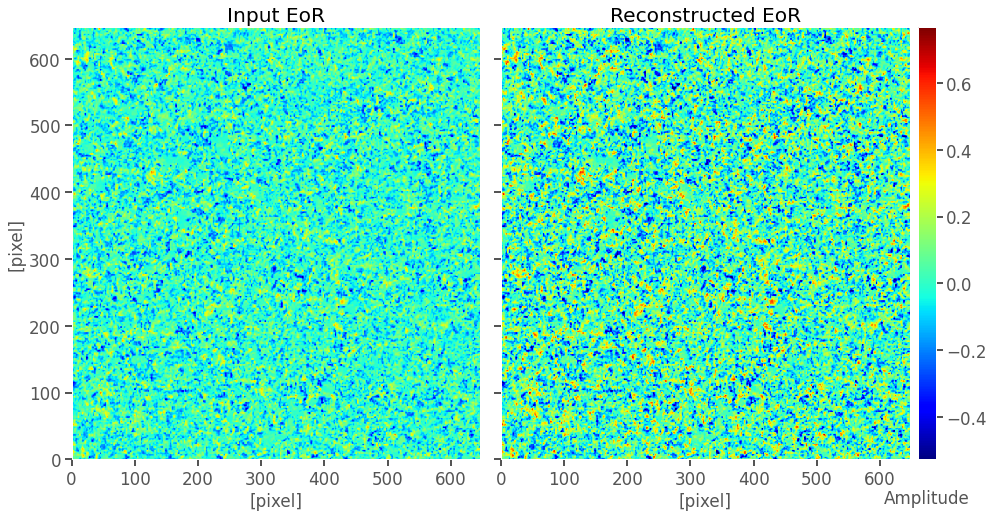

In [7]:
# 做逆傅里叶变换，在实空间上展示模型对测试集的预测效果
# 从结果可以看到，模型能够较好地还原出eor的细节特征

def irfft_cube(x, nex):
    npix, nf, __ = x.shape
    nf0 = nf + 2*nex - 1
    n = int(npix**0.5)
    z = rfft_decode2(x[:, :, 0], nex=nex)  # [npix, nf*]
    y = np.fft.irfft(z, n=nf0, axis=1)  # [npix, nf0]
    y2 = np.swapaxes(y, 0, 1)  # [nf0, npix]
    return y2.reshape((nf0, n, n))


def plot_slice_eor(cube_in, cube_out, i=15, figsize=(12, 6)):
    slc_in  = cube_in[i, :, :]
    slc_out = cube_out[i, :, :]
    nx, ny  = slc_in.shape
    vmin, vmax = np.min(slc_in), np.max(slc_out)

    fig, axes = plt.subplots(ncols=2, figsize=figsize)

    ax = axes[0]
    mappable = ax.pcolormesh(np.arange(nx), np.arange(ny), slc_in, cmap='jet',
                             vmin=vmin, vmax=vmax)
    ax.set(title='Input EoR', xlabel='[pixel]', ylabel='[pixel]')

    ax = axes[1]
    mappable = ax.pcolormesh(np.arange(nx), np.arange(ny), slc_out, cmap='jet',
                             vmin=vmin, vmax=vmax)
    ax.set(title='Reconstructed EoR', xlabel='[pixel]')
    ax.yaxis.set_ticklabels([])

    fig.subplots_adjust(top=1, bottom=0, left=0, right=0.97, wspace=0.05)
    
    cax = fig.add_axes([0.98, 0.0, 0.02, 1.0])  # [left, bottom, width, height]
    cb = fig.colorbar(mappable, cax=cax)
    cb.ax.set_xlabel('Amplitude')
    cb.ax.xaxis.labelpad = 30

    plt.show()
    return (fig, axes)

x_test_pred = model.predict(x_test)
cin_eor  = irfft_cube(x_test_label, nex=nex)
cout_eor = irfft_cube(x_test_pred,  nex=nex)

fig, axes = plot_slice_eor(cin_eor, cout_eor)

if False:
    fn = 'eor-img-comp(fre=152.0).png'
    fig.savefig(fn, bbox_inches='tight', dpi=150)
    print('figure saved to file: %s' % path.abspath(fn))

<span style="font-size:20px">**基于cdae-eor代码对skymap学习的良好效果，接下来尝试沿用原来代码直接从dirtymap还原21cm信号**  
**直接使用原代码学习效果非常差，尝试对其进行优化看能否解决问题**

<span style="font-size:15px">尝试的一些方法主要有：  
    - 加深网络结构  
    - 对数据进行预处理，在放大其特征的同时保持单值性，使得预处理后的数据能够还原回原来数据  
    - （不是自己尝试的）若预先使用模拟的psf对dirtymap用退卷积方法进行去噪仍然会有一些边缘效应以及离散傅里叶变换带来的效应，故采用机器学习方法可能能更好地对着部分效应进行修正  
    
<span style="font-size:20px">**但这些方法对预测结果的优化效果似乎都不甚明显，cdae-eor算法无法很好地从现有模拟的dirtymap中学习出21cm信号**


<span style="font-size:20px">**关键的问题就在于一个简单结构的网络或许无法同时从dirtymap中学习出skymap与psf的特征**  
**不难想到，解决这个问题的关键在于对于psf特征的学习**
**因此，参考fork_lens算法，采用分支状网络结构同时学习psf与dirtymap，并用全连接层将两者分别经过卷积网络后的结果连接，以达到去除psf的效果**

<span style="font-size:20px">**下面是fork_eor代码**
**（从dirtymap学习skymap）**

In [2]:
# 加载库与预设函数
# 这里需要切换到tf27环境，因为程序已基本完全重新编写，故采用更新版本的TensorFlow库

#import库
import os
from os import path
from datetime import datetime
import time

import numpy as np
from astropy.io import fits

from scipy import signal
from scipy import fftpack

import matplotlib as mpl
import matplotlib.pyplot as plt

#%matplotlib inline

mpl.style.use("ggplot")
for k, v in [("font.family",       "DejaVu Serif"),
             ("font.size",         14.0),
             ("pdf.fonttype",      42),  # Type 42 (a.k.a. TrueType)
             ("figure.figsize",    [8, 6]),
             ("image.cmap",        "jet"),
             ("xtick.labelsize",   "large"),
             ("xtick.major.size",  7.0),
             ("xtick.major.width", 2.0),
             ("xtick.minor.size",  4.0),
             ("xtick.minor.width", 1.5),
             ("ytick.labelsize",   "large"),
             ("ytick.major.size",  7.0),
             ("ytick.major.width", 2.0),
             ("ytick.minor.size",  4.0),
             ("ytick.minor.width", 1.5)]:
    mpl.rcParams[k] = v

import tensorflow as tf
from keras import backend as K
from keras.models import Model
from keras.layers import Input, Conv1D, MaxPooling1D, Flatten, Dense, concatenate, BatchNormalization
from tensorflow.keras.layers import Add

# Define the correlation coefficient metric
def correlation_coefficient(y_true, y_pred):
    # Calculate the correlation coefficient
    true_mean = K.mean(y_true)
    pred_mean = K.mean(y_pred)
    true_std = K.std(y_true)
    pred_std = K.std(y_pred)
    covariance = K.mean((y_true - true_mean) * (y_pred - pred_mean))
    correlation = covariance / (true_std * pred_std + K.epsilon())

    return correlation

def plot_slice_eor(cube_in, cube_out,figsize=(12, 6)):
    slc_in  = cube_in
    slc_out = cube_out
    nx, ny  = slc_in.shape
    #vmin, vmax = np.min(slc_in), np.max(slc_out)
    vmin,vmax=0.5,1.0
    fig, axes = plt.subplots(ncols=2, figsize=figsize)

    ax = axes[0]
    mappable1 = ax.pcolormesh(np.arange(ny), np.arange(nx), slc_in, cmap='jet',
                             vmin=vmin, vmax=vmax)
    ax.set(title='Input EoR', xlabel='[pixel]', ylabel='[pixel]')

    ax = axes[1]
    mappable2 = ax.pcolormesh(np.arange(ny), np.arange(nx), slc_out, cmap='jet',
                             vmin=vmin, vmax=vmax)
    ax.set(title='Reconstructed EoR', xlabel='[pixel]')
    ax.yaxis.set_ticklabels([])

    fig.subplots_adjust(top=1, bottom=0, left=0, right=0.97, wspace=0.05)
    
    cax = fig.add_axes([0.98, 0.0, 0.02, 1.0])  # [left, bottom, width, height]
    cb = fig.colorbar(mappable1, cax=cax)
    cb.ax.set_xlabel('Amplitude')
    cb.ax.xaxis.labelpad = 30

    plt.show()
    return (fig, axes)

def preprocess_ds_noft(cube_tot, cube_eor, q=(1, 99)):
    nf, ny, nx = cube_tot.shape
    x_data  = np.swapaxes(np.array(cube_tot.reshape((nf, ny*nx))), 0, 1)
    x_label = np.swapaxes(np.array(cube_eor.reshape((nf, ny*nx))), 0, 1)
    if nf % 2 == 1:
        # Make the number of frequencies even to avoid hacking the paddings.
        x_data  = x_data [:, :-1]
        x_label = x_label[:, :-1]

    x_data -= np.mean(x_data, axis=1, keepdims=True)
    x_data /= np.std(x_data)
    
    x_label -= np.mean(x_label, axis=1, keepdims=True)
    vlow, vhigh = np.percentile(x_label, q=q)
    x_label[x_label < vlow]  = vlow
    x_label[x_label > vhigh] = vhigh
    x_label /= max(abs(vlow), abs(vhigh))
    
    return (x_data, x_label)


2024-01-12 15:01:09.295390: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/hwloc/lib:/usr/local/lib/:/usr/local/lib64/:/opt/mpi/lib:/opt/dtk-22.10/hip/lib:/opt/dtk-22.10/llvm/lib:/opt/dtk-22.10/lib:/opt/dtk-22.10/lib64:/opt/rh/devtoolset-7/root/usr/lib64:/opt/rh/devtoolset-7/root/usr/lib:/opt/rh/devtoolset-7/root/usr/lib64/dyninst:/opt/rh/devtoolset-7/root/usr/lib/dyninst:/opt/rh/devtoolset-7/root/usr/lib64:/opt/rh/devtoolset-7/root/usr/lib:/opt/dtk/hip/lib:/opt/dtk/llvm/lib:/opt/dtk/lib:/opt/dtk/lib64:/opt/rh/devtoolset-7/root/usr/lib64:/opt/rh/devtoolset-7/root/usr/lib:/opt/rh/devtoolset-7/root/usr/lib64/dyninst:/opt/rh/devtoolset-7/root/usr/lib/dyninst:/opt/rh/devtoolset-7/root/usr/lib64:/opt/rh/devtoolset-7/root/usr/lib:/opt/mpi/lib:/opt/hwloc/lib:/usr/local/lib/:/usr/local/lib64/:
2024-01-12 15:01:09.29543

In [2]:
# 设定网络模型
# 这里模型较为简单，每个fork分别有四层，最后再加几层全连接层
# 经过实验，加深每个fork中网络的深度对训练效果的提升不明显，但训练时间会大大延长
# 之后如何优化网络结构还有待解决
def create_model():
    # Input layers
    input1 = Input(shape=(60, 1))
    input2 = Input(shape=(60, 1))

    # Branch 1 
    branch1 = Conv1D(32, 3, activation='relu')(input1)
    branch1 = MaxPooling1D(2)(branch1)
    branch1 = Conv1D(64, 3, activation='relu')(branch1)
    branch1 = MaxPooling1D(2)(branch1)
    branch1 = Conv1D(128, 3, activation='relu')(branch1)
    branch1 = MaxPooling1D(2)(branch1)
    branch1 = Conv1D(256, 3, activation='relu')(branch1)
    branch1 = MaxPooling1D(2)(branch1)
    branch1 = Flatten()(branch1)
    
    # Branch 2
    branch2 = Conv1D(32, 3, activation='relu')(input2)
    branch2 = MaxPooling1D(2)(branch2)
    residual = branch2
    branch2 = Conv1D(64, 3, activation='relu')(branch2)
    branch2 = MaxPooling1D(2)(branch2)
    branch2 = Conv1D(128, 3, activation='relu')(branch2)
    branch2 = MaxPooling1D(2)(branch2)
    branch2 = Conv1D(256, 3, activation='relu')(branch2)
    branch2 = MaxPooling1D(2)(branch2)
    branch2 = Flatten()(branch2)

    # Concatenate the branches
    merged = concatenate([branch1, branch2])
    print(merged.shape)
    
    # Dense layers
    dense1 = Dense(512, activation='relu')(merged)
    dense2 = Dense(256, activation='relu')(dense1)
    dense3 = Dense(128, activation='relu')(dense2)
    dense4 = Dense(64, activation='relu')(dense3)
    dense5 = Dense(32, activation='relu')(dense4)
    
    # NN calibration structure
    calibration = Dense(128, activation='relu')(dense3)
    calibration = Dense(64, activation='relu')(calibration)
    calibration = Dense(32, activation='relu')(calibration)
    calibration = Dense(16, activation='relu')(calibration)
    calibration_output = Dense(60, activation='sigmoid')(calibration)

    # Create the model
    model = Model(inputs=[input1, input2], outputs=calibration_output)
    return model

# Create the forked CNN model
model = create_model()

# Compile the model with the correlation coefficient metric
model.compile(optimizer='adam', loss='mean_squared_error', metrics=[correlation_coefficient])

model.summary()

2024-01-12 13:11:23.088204: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /opt/hwloc/lib:/usr/local/lib/:/usr/local/lib64/:/opt/mpi/lib:/opt/dtk-22.10/hip/lib:/opt/dtk-22.10/llvm/lib:/opt/dtk-22.10/lib:/opt/dtk-22.10/lib64:/opt/rh/devtoolset-7/root/usr/lib64:/opt/rh/devtoolset-7/root/usr/lib:/opt/rh/devtoolset-7/root/usr/lib64/dyninst:/opt/rh/devtoolset-7/root/usr/lib/dyninst:/opt/rh/devtoolset-7/root/usr/lib64:/opt/rh/devtoolset-7/root/usr/lib:/opt/dtk/hip/lib:/opt/dtk/llvm/lib:/opt/dtk/lib:/opt/dtk/lib64:/opt/rh/devtoolset-7/root/usr/lib64:/opt/rh/devtoolset-7/root/usr/lib:/opt/rh/devtoolset-7/root/usr/lib64/dyninst:/opt/rh/devtoolset-7/root/usr/lib/dyninst:/opt/rh/devtoolset-7/root/usr/lib64:/opt/rh/devtoolset-7/root/usr/lib:/opt/mpi/lib:/opt/hwloc/lib:/usr/local/lib/:/usr/local/lib64/:
2024-01-12 13:11:23.088273: W tenso

(None, 512)
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 60, 1)]      0           []                               
                                                                                                  
 input_2 (InputLayer)           [(None, 60, 1)]      0           []                               
                                                                                                  
 conv1d (Conv1D)                (None, 58, 32)       128         ['input_1[0][0]']                
                                                                                                  
 conv1d_4 (Conv1D)              (None, 58, 32)       128         ['input_2[0][0]']                
                                                                                  

In [3]:
# 进行训练
# 这里训练集与测试集的分割不同于cdae-eor中将同一张天图分割成两部分，因为psf有明显的对称性，分割图片将破坏其对称性
# 采用的方法是一批数据中随机抽取出几组指定长度的**按顺序的、连续的**数据，前几组作为训练集，分几轮投喂进模型进行训练
# 该文档中设定的是一共进行了三轮在训练，每轮只训练1个epoch
# 之所以这样选取，是因为观察到数据集选取的连续性似乎对好的训练结果非常重要

# 生成抽取出的数据集序列
import random
random_indices = np.array(sorted(np.random.permutation(300))).astype(int)
round_indices = []
round_1 = random_indices[0:60]
round_indices = np.append(round_indices,round_1)
round_2 = round_1 + random.randint(60,80)
round_indices = np.append(round_indices,round_2)
round_3 = round_2 + random.randint(60,80)
round_indices = np.append(round_indices,round_3)
round_4 = round_3 + random.randint(60,80)
round_indices = np.append(round_indices,round_4).astype(int)

for round in range (0,3):
    print(f'{round} round training begins!')
    cube_21cm = np.zeros([60,2048,2048],dtype=float)
    cube_sync = np.zeros([60,2048,2048],dtype=float)
    cube_halo = np.zeros([60,2048,2048],dtype=float)
    cube_ff = np.zeros([60,2048,2048],dtype=float)
    cube_ptr = np.zeros([60,2048,2048],dtype=float)
    cube_dirty = np.zeros([60,2048,2048],dtype=float)
    cube_psf=np.zeros([60,2048,2048],dtype=float)


    freq=np.array(['139.00','139.10','139.20','139.30','139.40','139.50','139.60','139.70','139.80','139.90','140.00','140.10','140.20','140.30','140.40','140.50','140.60','140.70','140.80','140.90','141.00','141.10','141.20','141.30','141.40','141.50','141.60','141.70','141.80','141.90','142.00','142.10','142.20','142.30','142.40','142.50','142.60','142.70','142.80','142.90','143.00','143.10','143.20','143.30','143.40','143.50','143.60','143.70','143.80','143.90','144.00','144.10','144.20','144.30','144.40','144.50','144.60','144.70','144.80','144.90','145.00','145.10','145.20','145.30','145.40','145.50','145.60','145.70','145.80','145.90','146.00','146.10','146.20','146.30','146.40','146.50','146.60','146.70','146.80','146.90','147.00','147.10','147.20','147.30','147.40','147.50','147.60','147.70','147.80','147.90','148.00','148.10','148.20','148.30','148.40','148.50','148.60','148.70','148.80','148.90','149.00','149.10','149.20','149.30','149.40','149.50','149.60','149.70','149.80','149.90','150.00','150.10','150.20','150.30','150.40','150.50','150.60','150.70','150.80','150.90','151.00','151.10','151.20','151.30','151.40','151.50','151.60','151.70','151.80','151.90','152.00','152.10','152.20','152.30','152.40','152.50','152.60','152.70','152.80','152.90','153.00','153.10','153.20','153.30','153.40','153.50','153.60','153.70','153.80','153.90','154.00','154.10','154.20','154.30','154.40','154.50','154.60','154.70','154.80','154.90','155.00','155.10','155.20','155.30','155.40','155.50','155.60','155.70','155.80','155.90','156.00','156.10','156.20','156.30','156.40','156.50','156.60','156.70','156.80','156.90','157.00','157.10','157.20','157.30','157.40','157.50','157.60','157.70','157.80','157.90','158.00','158.10','158.20','158.30','158.40','158.50','158.60','158.70','158.80','158.90','159.00','159.10','159.20','159.30','159.40','159.50','159.60','159.70','159.80','159.90','160.00','160.10','160.20','160.30','160.40','160.50','160.60','160.70','160.80','160.90','161.00','161.10','161.20','161.30','161.40','161.50','161.60','161.70','161.80','161.90','162.00','162.10','162.20','162.30','162.40','162.50','162.60','162.70','162.80','162.90','163.00','163.10','163.20','163.30','163.40','163.50','163.60','163.70','163.80','163.90','164.00','164.10','164.20','164.30','164.40','164.50','164.60','164.70','164.80','164.90','165.00','165.10','165.20','165.30','165.40','165.50','165.60','165.70','165.80','165.90','166.00','166.10','166.20','166.30','166.40','166.50','166.60','166.70','166.80','166.90','167.00','167.10','167.20','167.30','167.40','167.50','167.60','167.70','167.80','167.90','168.00','168.10','168.20','168.30','168.40','168.50','168.60','168.70','168.80','168.90'])
    freq_chosen = freq[round_indices[60*round:60*(round+1)]]
    for i,j in enumerate(freq_chosen):
        file_21cm = '/public/share/ace66so15x/share/sdc3_skymap/eor/deltaTb_f'+j+'_N2048_fov9.1.fits'
        file_sync = '/public/share/ace66so15x/share/sdc3_skymap/sync/gsync_'+j+'.fits'
        file_halo = '/public/share/ace66so15x/share/sdc3_skymap/halo/cluster_'+j+'.fits'
        file_ff='/public/share/ace66so15x/share/sdc3_skymap/ff/gfree_'+j+'.fits'
        file_ptr='/public/share/ace66so15x/share/sdc3_skymap/ptr/ptr_'+j+'.fits'
        file_dirty = '/public/share/ace66so15x/share/sdc3/all_'+j+'/image_briggs/all_'+j+'-dirty.fits'
        file_psf = '/public/share/ace66so15x/share/sdc3/all_'+j+'/image_briggs/all_'+j+'-psf.fits'
        data_21cm = fits.open(file_21cm)
        data_sync = fits.open(file_sync)
        data_halo = fits.open(file_halo)
        data_ff = fits.open(file_ff)
        data_ptr = fits.open(file_ptr)
        data_dirty = fits.open(file_dirty)
        data_psf=fits.open(file_psf)


        cube_21cm[i] = data_21cm[0].data
        cube_sync[i] = data_sync[0].data
        cube_halo[i] = data_halo[0].data
        cube_ff[i]=data_ff[0].data
        cube_ptr[i]=data_ptr[0].data
        cube_dirty[i]=data_dirty[0].data
        cube_psf[i]=data_psf[0].data

    cube_total = cube_dirty
    cube_clean=cube_sync + cube_halo+cube_ff+cube_ptr+cube_21cm


    #划分与加载数据
    cube_eor1 = cube_clean
    cube_tot1 = cube_total
    cube_psf1 = cube_psf

    #划分三个数据集
    #这里对dirtymap和psf做同样的归一化与预处理操作
    #两者label的值是一样的
    x2_data_map, x2_label = preprocess_ds_noft(cube_tot1, cube_eor1)
    x2_data_psf, x2_label = preprocess_ds_noft(cube_psf1, cube_eor1)
    
    x1_train = x2_data_map[:,:,np.newaxis]
    x2_train = x2_data_psf[:,:,np.newaxis]
    y_train = x2_label[:,:]
    
    # Train the model
    if round != 0:
        model = tf.keras.models.load_model('forktrain_iteration_random_sequence.hdf5',custom_objects={'correlation_coefficient': correlation_coefficient})
    model.fit([x1_train, x2_train], y_train, epochs=1, batch_size=32)
    modelfile = f'forktrain_iteration_random_sequence.hdf5'
    model.save(modelfile)
    print(f'Saved model to file: {path.abspath(modelfile)}')
    
    #then clear all the data to release the memory
    del x1_train,x2_train,y_train
    #del x2_data_map, x2_label,x2_test_map, x2_test_label,x2_data_psf, x2_label2,x2_test_psf, x2_test_label2
    del cube_total,cube_clean,cube_psf
    del cube_eor1,cube_tot1,cube_psf1
    #del cube_eor2,cube_tot2,cube_fg2,cube_psf2

0 round training begins!
131072/131072 [==============================] - 1217s 9ms/step - loss: 0.1605 - correlation_coefficient: 0.8920
Saved model to file: /public/home/nyfan/code/forktrain_iteration_random_sequence.hdf5
1 round training begins!
131072/131072 [==============================] - 1221s 9ms/step - loss: 0.1585 - correlation_coefficient: 0.8978
Saved model to file: /public/home/nyfan/code/forktrain_iteration_random_sequence.hdf5
2 round training begins!
131072/131072 [==============================] - 1227s 9ms/step - loss: 0.1591 - correlation_coefficient: 0.8978
Saved model to file: /public/home/nyfan/code/forktrain_iteration_random_sequence.hdf5


In [6]:
# 准备测试集
cube_21cm = np.zeros([60,2048,2048],dtype=float)
cube_sync = np.zeros([60,2048,2048],dtype=float)
cube_halo = np.zeros([60,2048,2048],dtype=float)
cube_ff = np.zeros([60,2048,2048],dtype=float)
cube_ptr = np.zeros([60,2048,2048],dtype=float)
cube_dirty = np.zeros([60,2048,2048],dtype=float)
cube_psf=np.zeros([60,2048,2048],dtype=float)
freq=np.array(['139.00','139.10','139.20','139.30','139.40','139.50','139.60','139.70','139.80','139.90','140.00','140.10','140.20','140.30','140.40','140.50','140.60','140.70','140.80','140.90','141.00','141.10','141.20','141.30','141.40','141.50','141.60','141.70','141.80','141.90','142.00','142.10','142.20','142.30','142.40','142.50','142.60','142.70','142.80','142.90','143.00','143.10','143.20','143.30','143.40','143.50','143.60','143.70','143.80','143.90','144.00','144.10','144.20','144.30','144.40','144.50','144.60','144.70','144.80','144.90','145.00','145.10','145.20','145.30','145.40','145.50','145.60','145.70','145.80','145.90','146.00','146.10','146.20','146.30','146.40','146.50','146.60','146.70','146.80','146.90','147.00','147.10','147.20','147.30','147.40','147.50','147.60','147.70','147.80','147.90','148.00','148.10','148.20','148.30','148.40','148.50','148.60','148.70','148.80','148.90','149.00','149.10','149.20','149.30','149.40','149.50','149.60','149.70','149.80','149.90','150.00','150.10','150.20','150.30','150.40','150.50','150.60','150.70','150.80','150.90','151.00','151.10','151.20','151.30','151.40','151.50','151.60','151.70','151.80','151.90','152.00','152.10','152.20','152.30','152.40','152.50','152.60','152.70','152.80','152.90','153.00','153.10','153.20','153.30','153.40','153.50','153.60','153.70','153.80','153.90','154.00','154.10','154.20','154.30','154.40','154.50','154.60','154.70','154.80','154.90','155.00','155.10','155.20','155.30','155.40','155.50','155.60','155.70','155.80','155.90','156.00','156.10','156.20','156.30','156.40','156.50','156.60','156.70','156.80','156.90','157.00','157.10','157.20','157.30','157.40','157.50','157.60','157.70','157.80','157.90','158.00','158.10','158.20','158.30','158.40','158.50','158.60','158.70','158.80','158.90','159.00','159.10','159.20','159.30','159.40','159.50','159.60','159.70','159.80','159.90','160.00','160.10','160.20','160.30','160.40','160.50','160.60','160.70','160.80','160.90','161.00','161.10','161.20','161.30','161.40','161.50','161.60','161.70','161.80','161.90','162.00','162.10','162.20','162.30','162.40','162.50','162.60','162.70','162.80','162.90','163.00','163.10','163.20','163.30','163.40','163.50','163.60','163.70','163.80','163.90','164.00','164.10','164.20','164.30','164.40','164.50','164.60','164.70','164.80','164.90','165.00','165.10','165.20','165.30','165.40','165.50','165.60','165.70','165.80','165.90','166.00','166.10','166.20','166.30','166.40','166.50','166.60','166.70','166.80','166.90','167.00','167.10','167.20','167.30','167.40','167.50','167.60','167.70','167.80','167.90','168.00','168.10','168.20','168.30','168.40','168.50','168.60','168.70','168.80','168.90'])
freq_chosen=freq[round_indices[180:240]]
for i,j in enumerate(freq_chosen):
    file_21cm = '/public/share/ace66so15x/share/sdc3_skymap/eor/deltaTb_f'+j+'_N2048_fov9.1.fits'
    file_sync = '/public/share/ace66so15x/share/sdc3_skymap/sync/gsync_'+j+'.fits'
    file_halo = '/public/share/ace66so15x/share/sdc3_skymap/halo/cluster_'+j+'.fits'
    file_ff='/public/share/ace66so15x/share/sdc3_skymap/ff/gfree_'+j+'.fits'
    file_ptr='/public/share/ace66so15x/share/sdc3_skymap/ptr/ptr_'+j+'.fits'
    file_dirty = '/public/share/ace66so15x/share/sdc3/all_'+j+'/image_briggs/all_'+j+'-dirty.fits'
    file_psf = '/public/share/ace66so15x/share/sdc3/all_'+j+'/image_briggs/all_'+j+'-psf.fits'
    data_21cm = fits.open(file_21cm)
    data_sync = fits.open(file_sync)
    data_halo = fits.open(file_halo)
    data_ff = fits.open(file_ff)
    data_ptr = fits.open(file_ptr)
    data_dirty = fits.open(file_dirty)
    data_psf=fits.open(file_psf)


    cube_21cm[i] = data_21cm[0].data
    cube_sync[i] = data_sync[0].data
    cube_halo[i] = data_halo[0].data
    cube_ff[i]=data_ff[0].data
    cube_ptr[i]=data_ptr[0].data
    cube_dirty[i]=data_dirty[0].data
    cube_psf[i]=data_psf[0].data

cube_total = cube_dirty
cube_clean=cube_sync + cube_halo+cube_ff+cube_ptr+cube_21cm


#划分与加载数据
cube_eor1 = cube_clean
cube_tot1 = cube_total
cube_psf1 = cube_psf

#划分三个数据集
#这里对dirtymap和psf做同样的归一化与预处理操作
#两者label的值是一样的
x2_data_map, x2_label = preprocess_ds_noft(cube_tot1, cube_eor1)
x2_data_psf, x2_label = preprocess_ds_noft(cube_psf1, cube_eor1)

x1_train = x2_data_map[:,:,np.newaxis]
x2_train = x2_data_psf[:,:,np.newaxis]
y_train = x2_label[:,:]

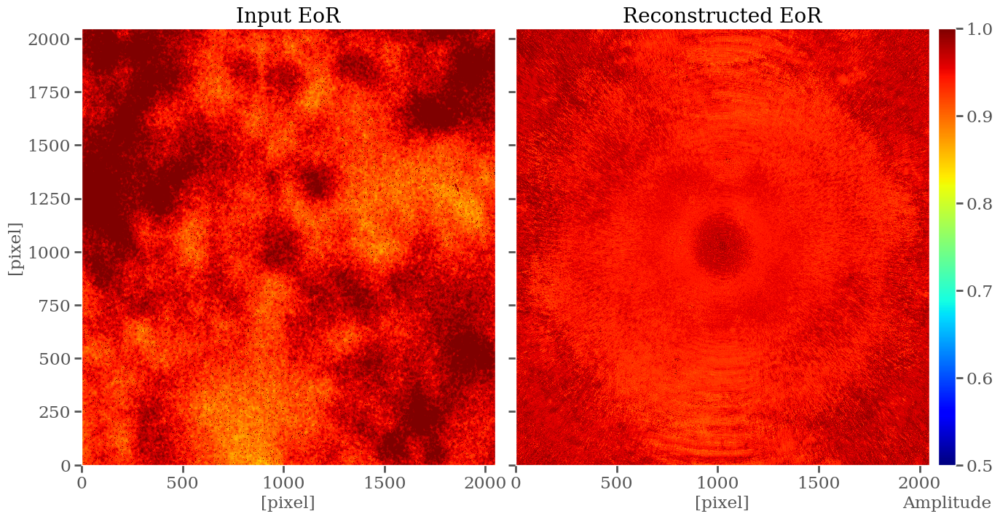

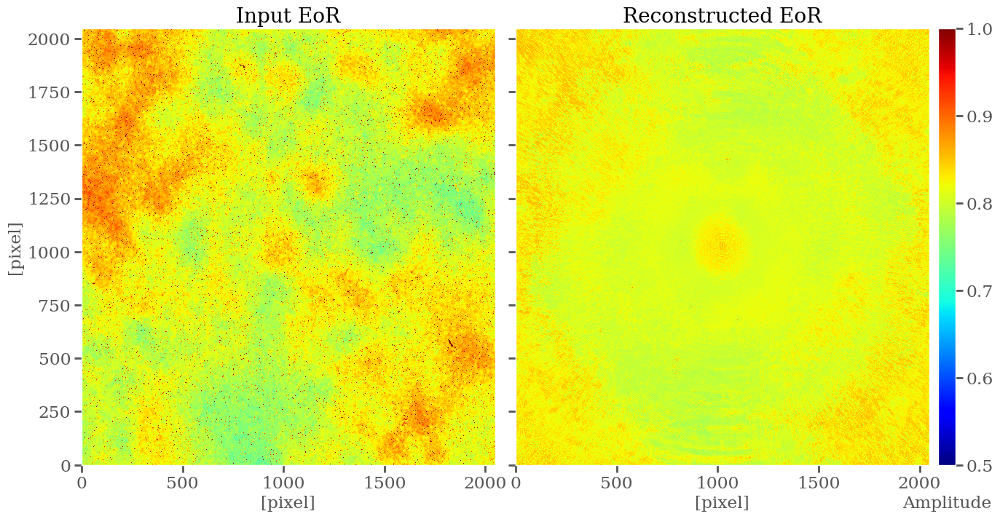

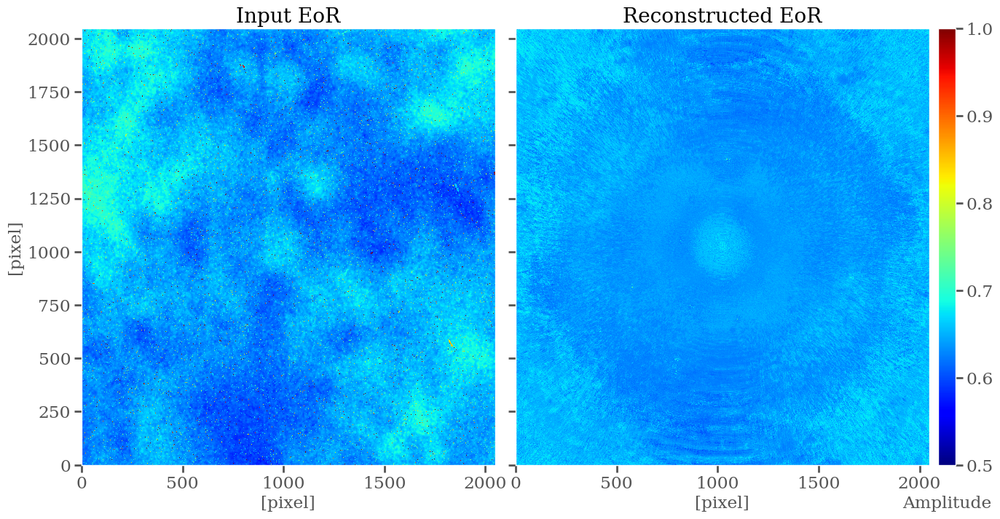

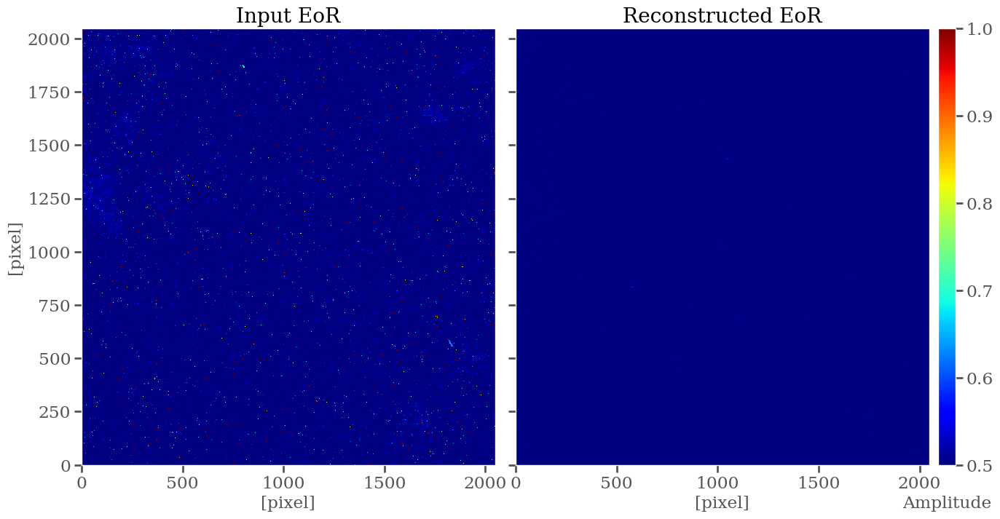

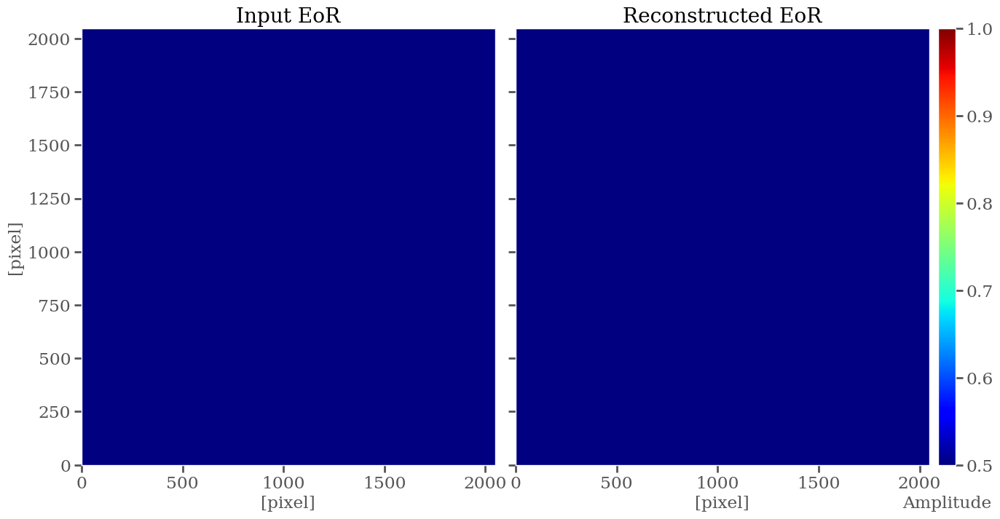

In [7]:
#载入训练出的模型并进行预测与作图

model = tf.keras.models.load_model('forktrain_iteration_random_sequence.hdf5',custom_objects={'correlation_coefficient': correlation_coefficient})

x2_test_map = x1_train
x2_test_psf = x2_train
x2_test_pred = model.predict([x2_test_map,x2_test_psf])
cin_eor  = y_train
cout_eor = x2_test_pred

for i in [1,5,10,15,30]:    
    in_map=cin_eor[:,i].reshape((2048,2048))
    out_map=cout_eor[:,i].reshape((2048,2048))
    fig, axes = plot_slice_eor(in_map, out_map)
if False:
    fn = 'eor-img-comp.png'
    fig.savefig(fn, bbox_inches='tight', dpi=150)
    print('figure saved to file: %s' % path.abspath(fn))

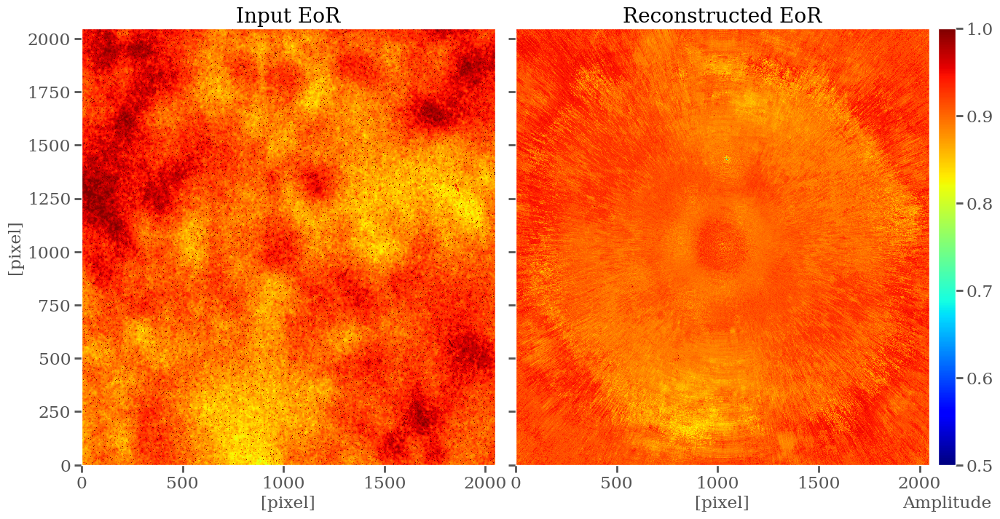

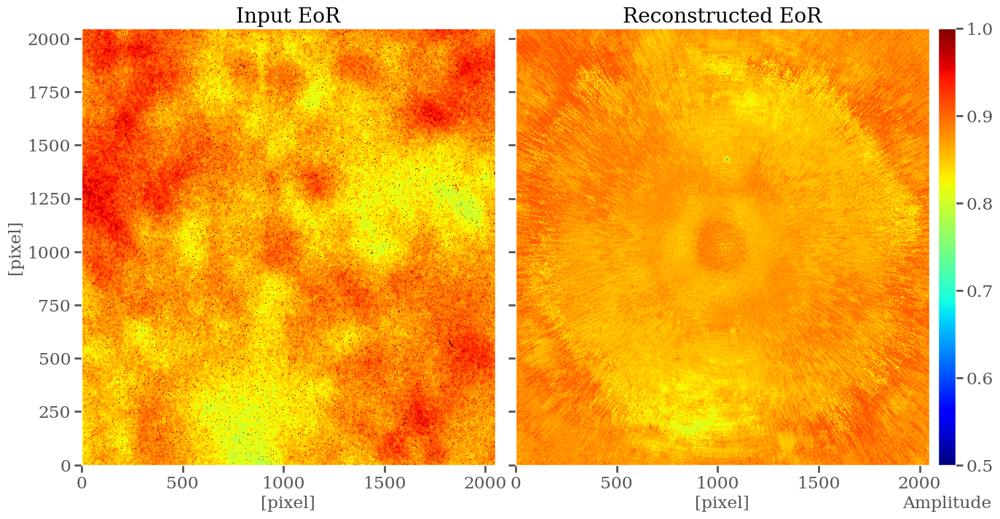

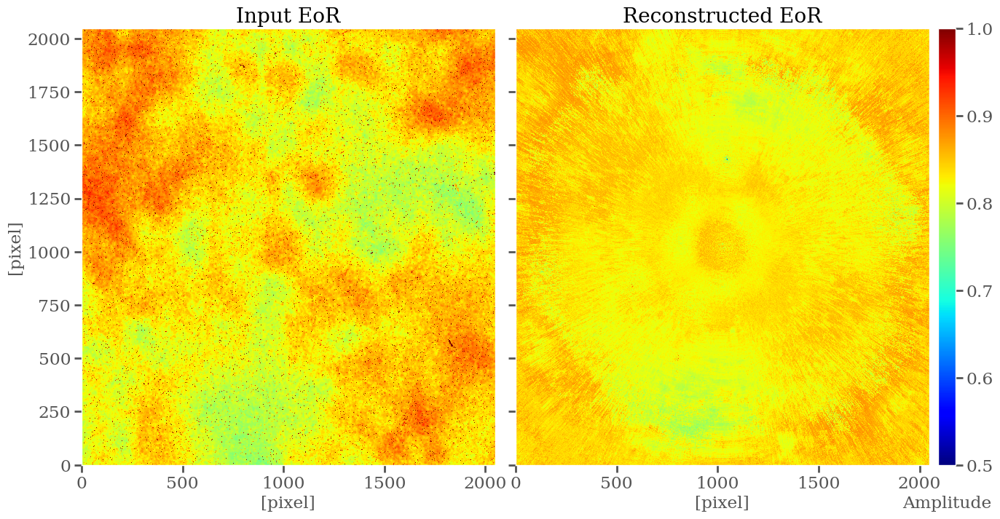

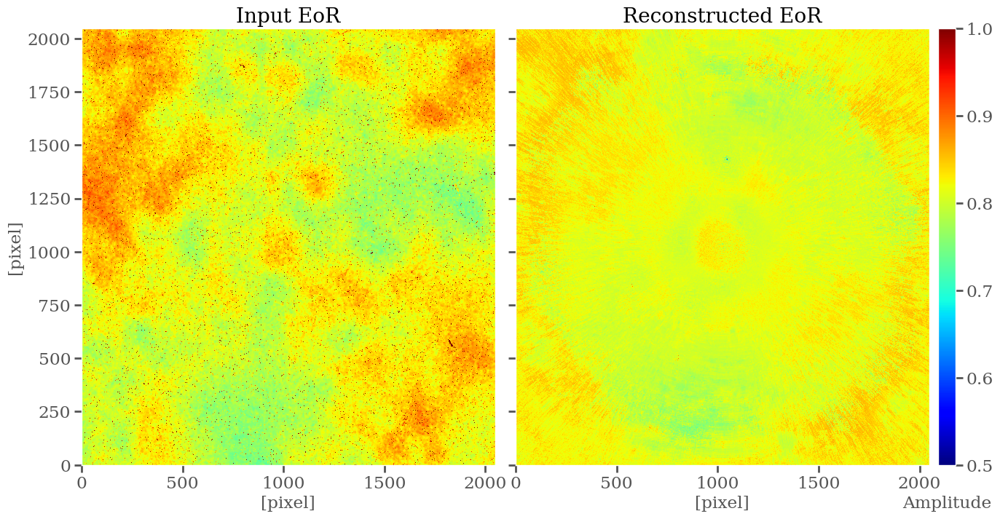

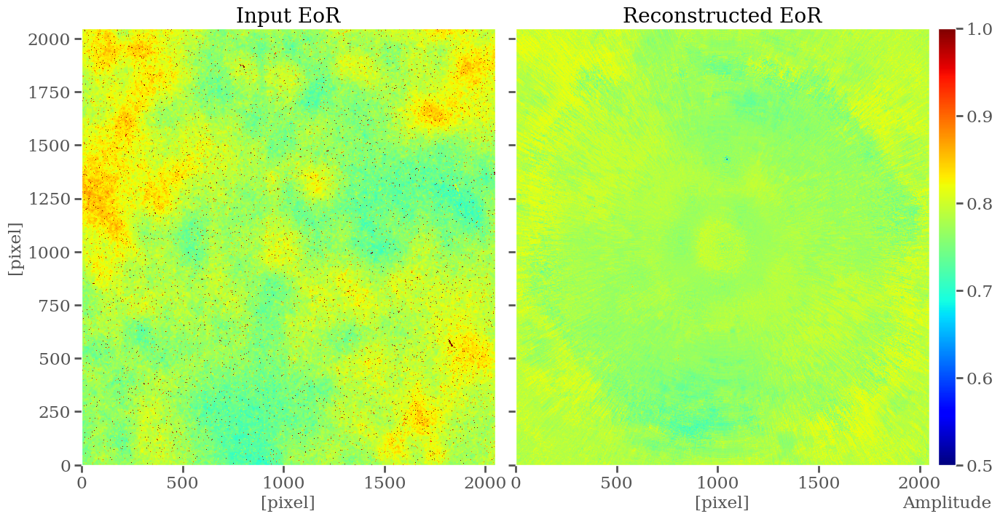

...

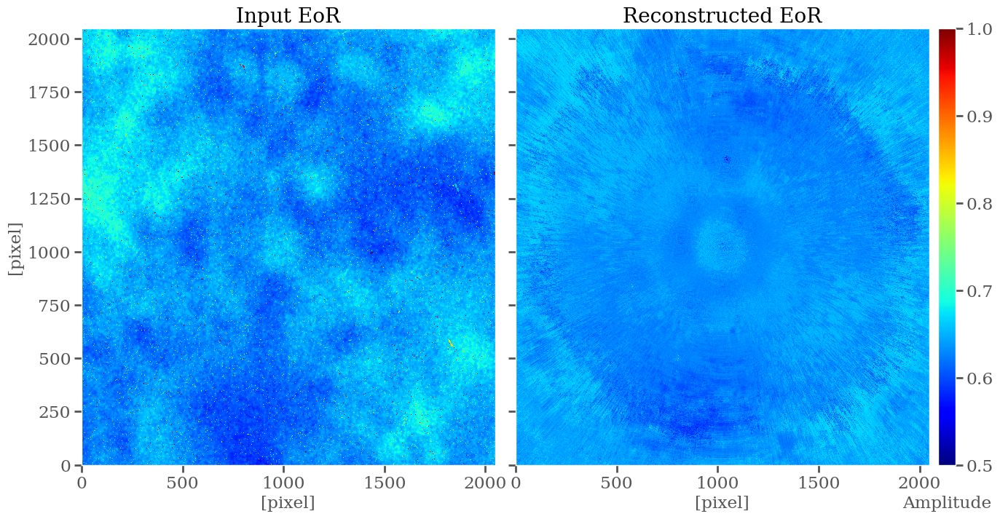

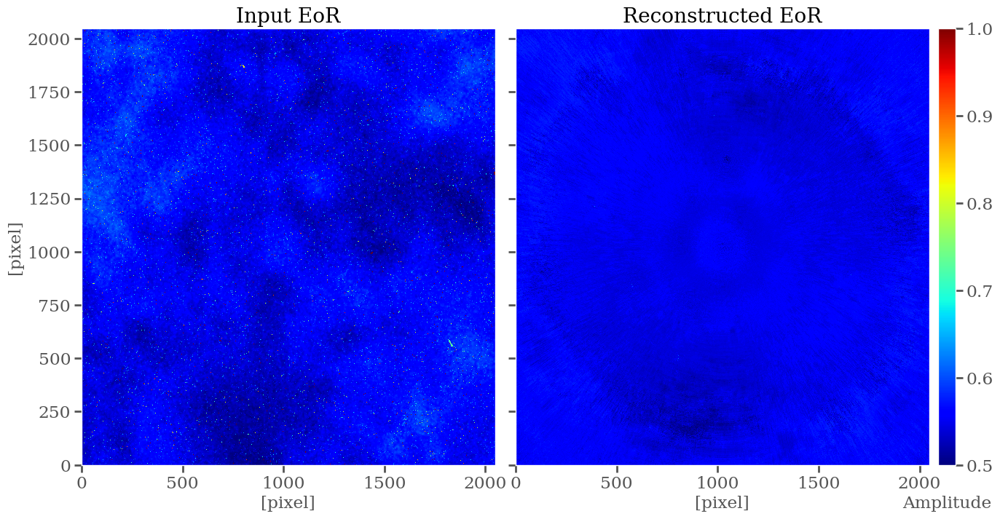

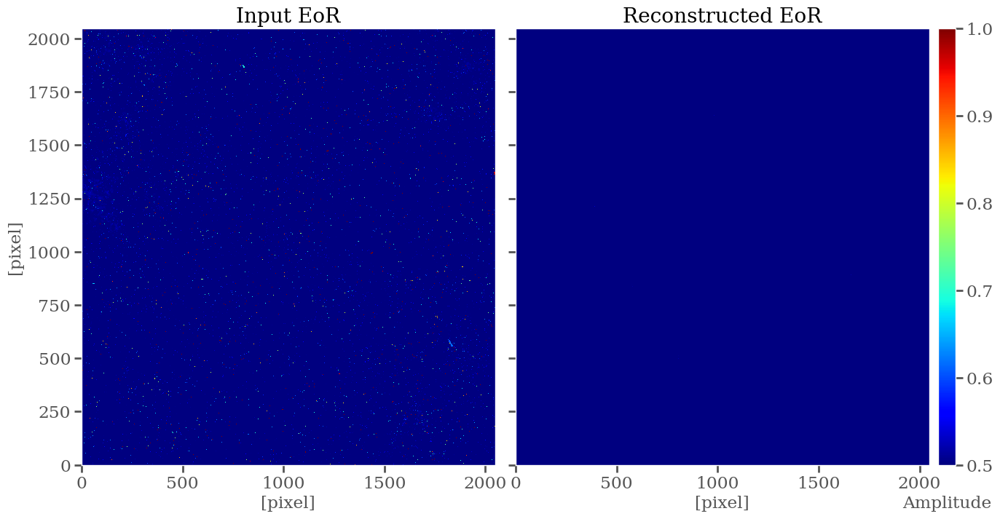

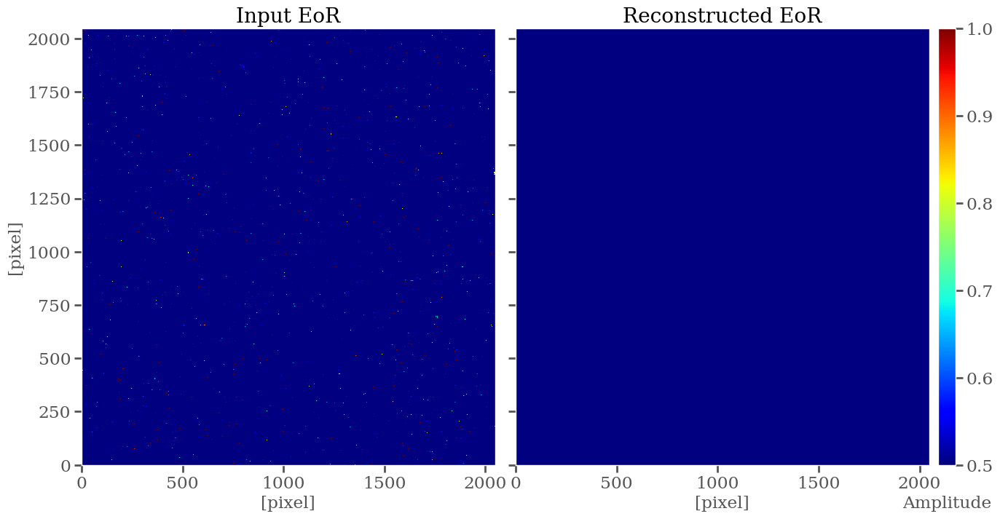

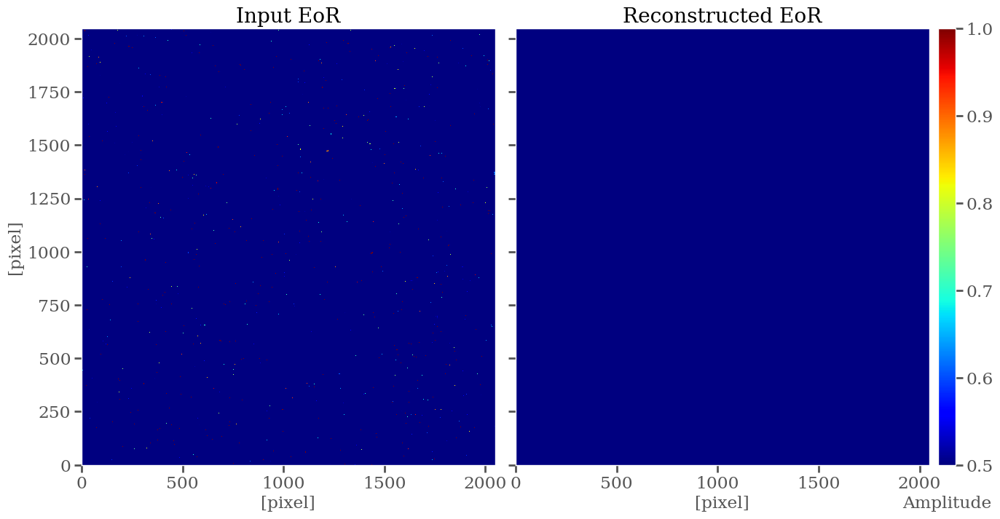

In [4]:
#这是另一种训练方法的尝试
#从240个数据中取出前120个用于训练，后120个作为测试集
#这里的训练效果看起来也不错
model = tf.keras.models.load_model('forktrain20240108T1205.hdf5',custom_objects={'correlation_coefficient': correlation_coefficient})

# 准备测试集
import numpy as np
freq=['157.00','157.10','157.20','157.30','157.40','157.50','157.60','157.70','157.80','157.90','158.00','158.10','158.20','158.30','158.40','158.50','158.60','158.70','158.80','158.90','159.00','159.10','159.20','159.30','159.40','159.50','159.60','159.70','159.80','159.90','160.00','160.10','160.20','160.30','160.40','160.50','160.60','160.70','160.80','160.90','161.00','161.10','161.20','161.30','161.40','161.50','161.60','161.70','161.80','161.90','162.00','162.10','162.20','162.30','162.40','162.50','162.60','162.70','162.80','162.90','163.00','163.10','163.20','163.30','163.40','163.50','163.60','163.70','163.80','163.90','164.00','164.10','164.20','164.30','164.40','164.50','164.60','164.70','164.80','164.90','165.00','165.10','165.20','165.30','165.40','165.50','165.60','165.70','165.80','165.90','166.00','166.10','166.20','166.30','166.40','166.50','166.60','166.70','166.80','166.90','167.00','167.10','167.20','167.30','167.40','167.50','167.60','167.70','167.80','167.90','168.00','168.10','168.20','168.30','168.40','168.50','168.60','168.70','168.80','168.90']
cube_21cm = np.zeros([120,2048,2048],dtype=float)
cube_sync = np.zeros([120,2048,2048],dtype=float)
cube_halo = np.zeros([120,2048,2048],dtype=float)
cube_ff = np.zeros([120,2048,2048],dtype=float)
cube_ptr = np.zeros([120,2048,2048],dtype=float)
cube_dirty = np.zeros([120,2048,2048],dtype=float)
cube_psf=np.zeros([120,2048,2048],dtype=float)

for i,j in enumerate(freq):
    file_21cm = '/public/share/ace66so15x/share/sdc3_skymap/eor/deltaTb_f'+j+'_N2048_fov9.1.fits'
    file_sync = '/public/share/ace66so15x/share/sdc3_skymap/sync/gsync_'+j+'.fits'
    file_halo = '/public/share/ace66so15x/share/sdc3_skymap/halo/cluster_'+j+'.fits'
    file_ff='/public/share/ace66so15x/share/sdc3_skymap/ff/gfree_'+j+'.fits'
    file_ptr='/public/share/ace66so15x/share/sdc3_skymap/ptr/ptr_'+j+'.fits'
    file_dirty = '/public/share/ace66so15x/share/sdc3/all_'+j+'/image_briggs/all_'+j+'-dirty.fits'
    file_psf = '/public/share/ace66so15x/share/sdc3/all_'+j+'/image_briggs/all_'+j+'-psf.fits'
    data_21cm = fits.open(file_21cm)
    data_sync = fits.open(file_sync)
    data_halo = fits.open(file_halo)
    data_ff = fits.open(file_ff)
    data_ptr = fits.open(file_ptr)
    data_dirty = fits.open(file_dirty)
    data_psf=fits.open(file_psf)


    cube_21cm[i] = data_21cm[0].data
    cube_sync[i] = data_sync[0].data
    cube_halo[i] = data_halo[0].data
    cube_ff[i]=data_ff[0].data
    cube_ptr[i]=data_ptr[0].data
    cube_dirty[i]=data_dirty[0].data
    cube_psf[i]=data_psf[0].data

cube_total = cube_dirty
cube_clean=cube_sync + cube_halo+cube_ff+cube_ptr+cube_21cm
cube_total=cube_total
cube_clean=cube_clean
cube_dirtyfg=cube_total-cube_clean
cube_psf=cube_psf

#划分与加载数据
cube_eor1 = cube_clean
cube_tot1 = cube_total
cube_fg1 = cube_dirtyfg
cube_psf1=cube_psf

x2_data_map, x2_label      = preprocess_ds_noft(cube_tot1,  cube_eor1)
x2_data_psf, x2_label2      = preprocess_ds_noft(cube_psf1,  cube_eor1)

x1_test = x2_data_map[:,:,np.newaxis]
x2_test = x2_data_psf[:,:,np.newaxis]
y_test = x2_label[:,:]

# 预测
x2_test_pred = model.predict([x1_test,x2_test])
cin_eor  = y_test
cout_eor = x2_test_pred

for i in [5,7,9,10,12,14,15,20,25,30,35,40]:    
    cin_eor=y_test[:,i].reshape((2048,2048))
    cout_eor=x2_test_pred[:,i].reshape((2048,2048))
    fig, axes = plot_slice_eor(cin_eor, cout_eor)

<span style="font-size:25px">**对上述工作的总结**  
- **对不同的成分进行了作图，观察其特征--传统EOR去前景方法的不适用**
- **cdae-eor进行skymap→eor signal的学习，基本能够预测出eor signal的细节特征**
- **cdae-eor在dirtymap→eor signal的学习上是基本失效的**
- **fork-eor在不同的训练模式下进行dirtymap→skymap的学习，目前从整体上看能取得还可以的训练效果**

<span style="font-size:25px">**后续的工作中要回答的几个关键问题是**  
- **现在的模型的训练效果还没有非常好，即使在训练集上的correlation coefficient也只是达到了接近0.9，而且从预测的图像上来看还能明显地看到psf的形状，对skymap各个方向上的差异的预测效果不够好（或许可以尝试多增加全连接层和calibration层？）。同时，在优化网络的过程中需要面对的一个paradox是在大量学习参数和大量输入数据的情况下，训练时间和所需内存都会大大增加，仿照forklens把其中一个fork替换成Resnet34,Resnet50之类的复杂网络需要的训练时间应该会非常长...**
- **是否存在过拟合问题？如果换了新的一批模拟数据，发现确实过拟合了，要如何解决？机器学习策略上当然可以采取比如增加正则化惩罚项等方式，但是更本质上的问题是，我们所要做的预测是否真得能通过神经网络表征出其内在的规律性，如果不行，或许算法上的优化效果都不会太显著。**